In [6]:
import pandas as pd    
import numpy as np
from models import *
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import bar_chart_race as bcr
import Levenshtein
from sqlalchemy import create_engine

In [2]:
warnings.simplefilter(action='ignore', category=pd.errors.SettingWithCopyWarning)

In [3]:
data = pd.read_excel("../scrapers/cleaned_data_2024/final_data_regata.xlsx")

In [4]:
data.shape

(139087, 15)

In [6]:
for classe in ["ILCA 7", "ILCA 6", "49ER", "49ERFX", "IQFOIL FEM."]:

    data_temp = data[data['Classe Vela'] == classe]

    for k_elo in [20, 40, 100]:

        elo = EloRating(ratings={competitor: 1500 for competitor in data_temp['Nome Competidor'].unique()}, k=k_elo)

        # Extrair o ano da competição e adicioná-lo ao dataframe
        for competition in data_temp['Nome Competição']:
            data_temp.loc[data_temp['Nome Competição'] == competition, 'Ano'] = int(re.findall(r'\d{4}', competition)[0])

        # Agrupar os dados por ano, competição, regata e competidor
        grouped_data = data_temp.groupby(["Ano", "Nome Competição", "Regata", "Nome Competidor"]).agg({"Posição Geral": "min"}).sort_values(by=["Ano", "Nome Competição", "Regata", "Posição Geral"], ascending=True).reset_index()

        # Preparar os dados no formato necessário para o cálculo do erro
        data_dict = []
        for ano in grouped_data["Ano"].unique():
            for comp in grouped_data[grouped_data["Ano"] == ano]["Nome Competição"].unique():
                for regata in grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Regata"].unique():
                    results = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Posição Geral"].values
                    names = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Nome Competidor"].values
                    data_dict.append([results, names])

        # Treinar o modelo ELO com os dados
        elo.fit(data_dict)
        ratings = elo.ratings

        ratings = pd.DataFrame.from_dict(ratings, orient='index', columns=['Rating']).sort_values(by="Rating")
        ratings.to_csv('../rankings_2024/novo/regata/elo-' + str(k_elo) + '-' + f"{classe}_regata" + '.csv')
        print(f"OK - {classe} - {k_elo}")

OK - ILCA 7 - 20
OK - ILCA 7 - 40
OK - ILCA 7 - 100
OK - ILCA 6 - 20
OK - ILCA 6 - 40
OK - ILCA 6 - 100
OK - 49ER - 20
OK - 49ER - 40
OK - 49ER - 100
OK - 49ERFX - 20
OK - 49ERFX - 40
OK - 49ERFX - 100
OK - IQFOIL FEM. - 20
OK - IQFOIL FEM. - 40
OK - IQFOIL FEM. - 100


In [211]:
for classe in ["ILCA 7", "ILCA 6", "49ER", "49ERFX", "IQFOIL FEM."]:

    data_temp = data[data['Classe Vela'] == classe]

    for k_elo in [20, 40, 100]:

        elo = EloRating(ratings={competitor: 1500 for competitor in data_temp['Nome Competidor'].unique()}, k=k_elo)
        for competition in data_temp['Nome Competição']:
            data_temp.loc[data_temp['Nome Competição'] == competition, 'Ano'] = int(re.findall(r'\d{4}', competition)[0])

        # get data in the format needed for error calculation
        data_dict = []
        grouped_data = data_temp.groupby(["Ano","Nome Competição", "Nome Competidor", ]).agg({"Posição Geral": "min"}
            ).sort_values(by=["Ano", "Nome Competição", "Posição Geral"], ascending=True).reset_index()

        for ano in grouped_data["Ano"].unique():
            for comp in grouped_data[grouped_data["Ano"] == ano]["Nome Competição"].unique():
                results = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Posição Geral"].values
                names = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Nome Competidor"].values
                data_dict.append([results, names])

        elo.fit(data_dict)
        ratings = elo.ratings

        ratings = pd.DataFrame.from_dict(ratings, orient='index', columns=['Rating']).sort_values(by="Rating")
        ratings.to_csv('../rankings_2024/novo/normal/elo-' + str(k_elo) + '-' + classe + '.csv')

# ILCA 7

In [7]:
elo_20 = pd.read_csv("../rankings_2024/novo/regata/elo-20-ILCA 7_regata.csv")
elo_40 = pd.read_csv("../rankings_2024/novo/regata/elo-40-ILCA 7_regata.csv")
elo_100 = pd.read_csv("../rankings_2024/novo/regata/elo-100-ILCA 7_regata.csv")

elo_20_normal = pd.read_csv("../rankings_2024/novo/normal/elo-20-ILCA 7.csv")
elo_40_normal = pd.read_csv("../rankings_2024/novo/normal/elo-40-ILCA 7.csv")
elo_100_normal = pd.read_csv("../rankings_2024/novo/normal/elo-100-ILCA 7.csv")

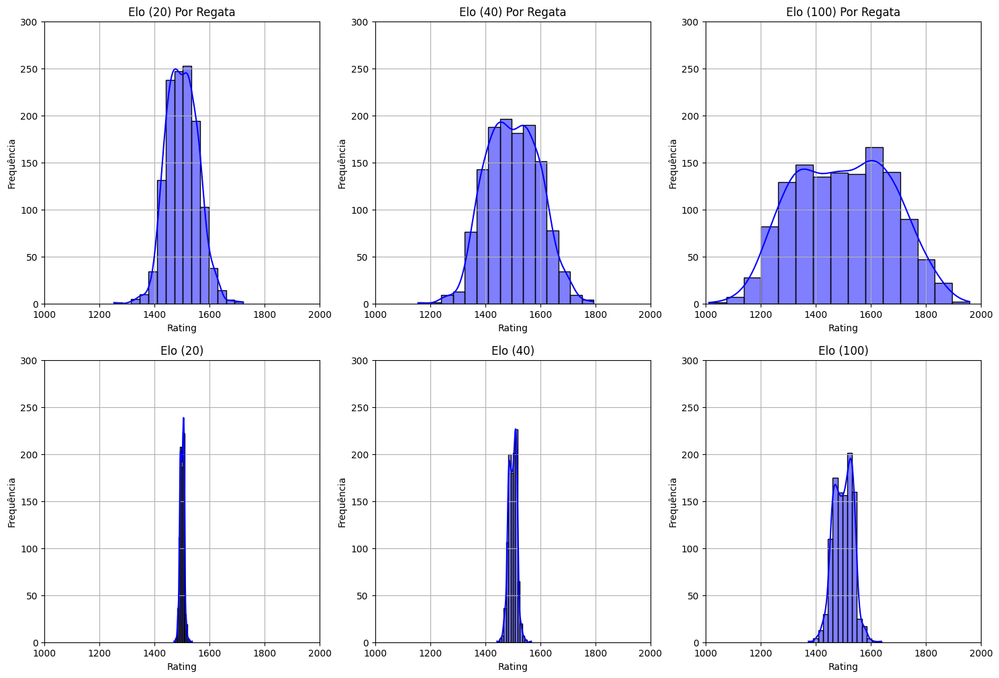

In [9]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20["Rating"], bins=15, kde=True, color='blue', ax=axes[0, 0]);
axes[0, 0].set_xlim(1000, 2000);
axes[0, 0].set_ylim(0, 300);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40["Rating"], bins=15, kde=True, color='blue', ax=axes[0, 1]);
axes[0, 1].set_xlim(1000, 2000);
axes[0, 1].set_ylim(0, 300);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100["Rating"], bins=15, kde=True, color='blue', ax=axes[0, 2]);
axes[0, 2].set_xlim(1000, 2000);
axes[0, 2].set_ylim(0, 300);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal["Rating"], bins=15, kde=True, color='blue', ax=axes[1, 0]);
axes[1, 0].set_xlim(1000, 2000);
axes[1, 0].set_ylim(0, 300);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal["Rating"], bins=15, kde=True, color='blue', ax=axes[1, 1]);
axes[1, 1].set_xlim(1000, 2000);
axes[1, 1].set_ylim(0, 300);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal["Rating"], bins=15, kde=True, color='blue', ax=axes[1, 2]);
axes[1, 2].set_xlim(1000, 2000);
axes[1, 2].set_ylim(0, 300);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [10]:
elo_40.tail(10)

,Unnamed: 0,Rating
1264,TOM BURTON,1714.521101
1265,ALEXANDER FINN,1721.177146
1266,FRANCISCO RENNA,1722.699417
1267,CHUSIT PUNJAMALA,1726.016946
1268,FIONN LYDEN,1729.663435
1269,GITESH NAIN,1732.358401
1270,RICARDO SEGUEL LACAMARA,1752.143841
1271,GUILLAUME GIROD,1772.720469
1272,THOMAS SAUNDERS,1774.861285
1273,CHARLIE BUCKINGHAM,1793.137931


In [11]:
elo_40_normal.tail(10)

,Unnamed: 0,Rating
1047,NORMAN STRUTHERS,1535.389958
1048,CHUSIT PUNJAMALA,1536.143630
1049,SPADONI ALESSIO,1537.217783
1050,FLORIAN HAFNER,1537.417834
1051,MICHAEL BECKETT,1541.336160
1052,FILIP JURISIC,1542.148214
1053,KARL-MARTIN RAMMO,1543.681754
1054,MALCOLM BENN SMITH,1544.251334
1055,RICARDO SEGUEL LACAMARA,1548.657440
1056,THOMAS SAUNDERS,1567.435201


# ILCA 6

In [12]:
elo_20_ilca6 = pd.read_csv("../rankings_2024/novo/regata/elo-20-ILCA 6_regata.csv")
elo_40_ilca6 = pd.read_csv("../rankings_2024/novo/regata/elo-40-ILCA 6_regata.csv")
elo_100_ilca6 = pd.read_csv("../rankings_2024/novo/regata/elo-100-ILCA 6_regata.csv")

elo_20_normal_ilca6 = pd.read_csv("../rankings_2024/novo/normal/elo-20-ILCA 6.csv")
elo_40_normal_ilca6 = pd.read_csv("../rankings_2024/novo/normal/elo-40-ILCA 6.csv")
elo_100_normal_ilca6 = pd.read_csv("../rankings_2024/novo/normal/elo-100-ILCA 6.csv")

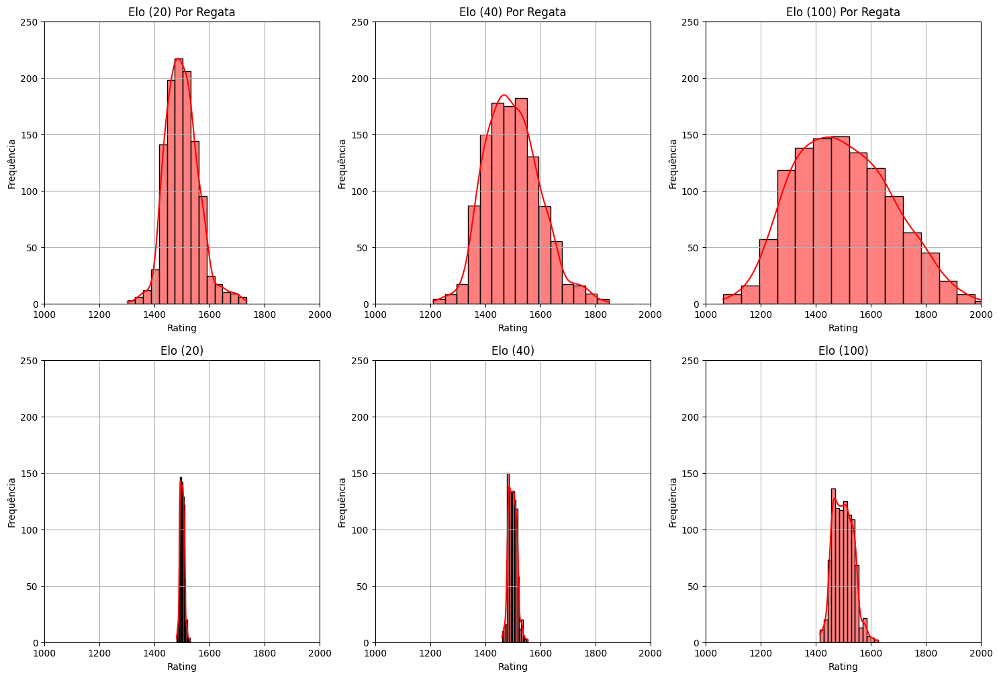

In [13]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[0, 0]);
axes[0, 0].set_xlim(1000, 2000);
axes[0, 0].set_ylim(0, 250);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[0, 1]);
axes[0, 1].set_xlim(1000, 2000);
axes[0, 1].set_ylim(0, 250);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[0, 2]);
axes[0, 2].set_xlim(1000, 2000);
axes[0, 2].set_ylim(0, 250);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[1, 0]);
axes[1, 0].set_xlim(1000, 2000);
axes[1, 0].set_ylim(0, 250);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[1, 1]);
axes[1, 1].set_xlim(1000, 2000);
axes[1, 1].set_ylim(0, 250);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[1, 2]);
axes[1, 2].set_xlim(1000, 2000);
axes[1, 2].set_ylim(0, 250);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [14]:
elo_40_ilca6.tail(10)

,Unnamed: 0,Rating
1108,SARAH DOUGLAS,1771.307531
1109,EVI VAN ACKER,1773.220716
1110,HANNAH SNELLGROVE,1773.259773
1111,MARIE BARRUE,1779.579510
1112,MARA STRANSKY,1780.767135
1113,MAUD JAYET,1784.584442
1114,MIRTHE AKKERMAN,1807.109827
1115,ERIKA REINEKE,1807.567671
1116,MICHON PERNELLE,1822.895450
1117,MARIA ERDI,1848.759515


In [15]:
elo_40_normal_ilca6.tail(10)

,Unnamed: 0,Rating
926,MARIA ERDI,1538.685997
927,ANNA MUNCH,1539.319610
928,SARAH DOUGLAS,1539.493717
929,ALEXANDER DE BIE,1542.088343
930,ERIKA REINEKE,1546.034555
931,MARIE BARRUE,1546.957807
932,LUCIA FALASCA,1547.694855
933,MIRTHE AKKERMAN,1549.056048
934,MICHON PERNELLE,1552.664773
935,EVI VAN ACKER,1555.267098


# 49ER

In [16]:
elo_20_49er = pd.read_csv("../rankings_2024/novo/regata/elo-20-49ER_regata.csv")
elo_40_49er = pd.read_csv("../rankings_2024/novo/regata/elo-40-49ER_regata.csv")
elo_100_49er = pd.read_csv("../rankings_2024/novo/regata/elo-100-49ER_regata.csv")

elo_20_normal_49er = pd.read_csv("../rankings_2024/novo/normal/elo-20-49ER.csv")
elo_40_normal_49er = pd.read_csv("../rankings_2024/novo/normal/elo-40-49ER.csv")
elo_100_normal_49er = pd.read_csv("../rankings_2024/novo/normal/elo-100-49ER.csv")

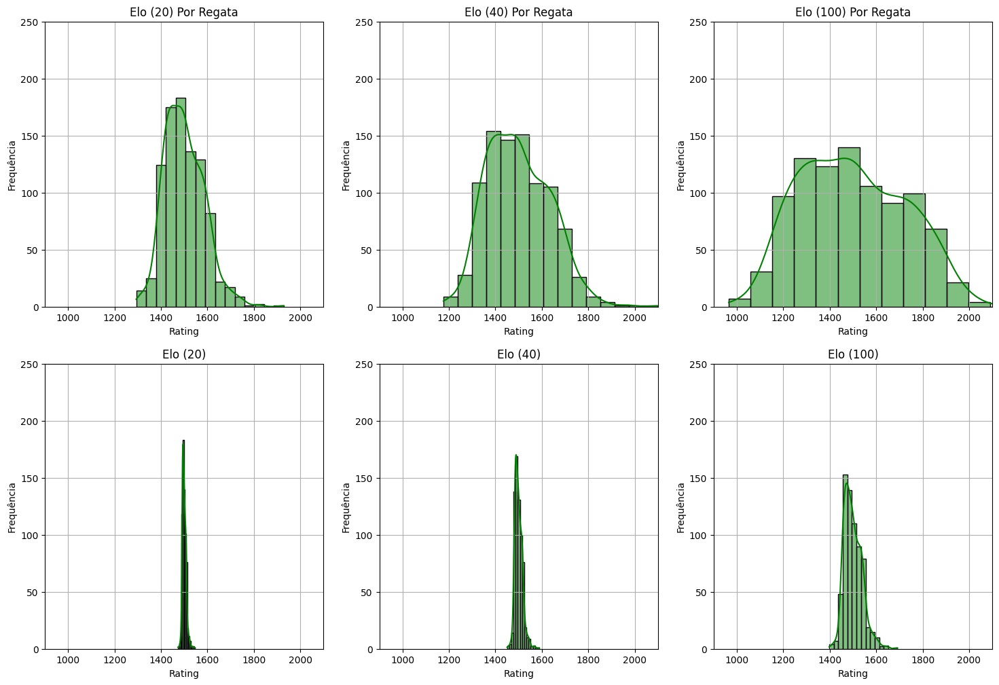

In [17]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_49er["Rating"], bins=15, kde=True, color='green', ax=axes[0, 0]);
axes[0, 0].set_xlim(900, 2100);
axes[0, 0].set_ylim(0, 250);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_49er["Rating"], bins=15, kde=True, color='green', ax=axes[0, 1]);
axes[0, 1].set_xlim(900, 2100);
axes[0, 1].set_ylim(0, 250);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_49er["Rating"], bins=15, kde=True, color='green', ax=axes[0, 2]);
axes[0, 2].set_xlim(900, 2100);
axes[0, 2].set_ylim(0, 250);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_49er["Rating"], bins=15, kde=True, color='green', ax=axes[1, 0]);
axes[1, 0].set_xlim(900, 2100);
axes[1, 0].set_ylim(0, 250);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_49er["Rating"], bins=15, kde=True, color='green', ax=axes[1, 1]);
axes[1, 1].set_xlim(900, 2100);
axes[1, 1].set_ylim(0, 250);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_49er["Rating"], bins=15, kde=True, color='green', ax=axes[1, 2]);
axes[1, 2].set_xlim(900, 2100);
axes[1, 2].set_ylim(0, 250);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [18]:
elo_40_49er.tail(10)

,Unnamed: 0,Rating
910,"IAN BARROWS, MITCHELL KISS",1817.636390
911,"JAMES PETERS, FYNN STERRITT",1826.904757
912,"MIKOLAJ STANIUL, KUBA SZTORCH",1829.940027
913,"NEVIN SNOW, DANE WILSON",1857.647320
914,"JACOPO PLAZZI, UMBERTO MOLINERIS",1870.039580
915,"CHRIS TAYLOR, RHOS HAWES",1875.005917
916,"ANDREW MOLLERUS, IAN MACDIARMID",1876.578222
917,"ERWAN FISCHER, CLEMENT PEQUIN",1952.699771
918,"BART LAMBRIEX, FLORIS VAN DE WERKEN",1976.166865
919,"PETER BURLING, BLAIR TUKE",2097.533370


In [19]:
elo_40_normal_49er.tail(10)

,Unnamed: 0,Rating
670,"HERNAN UMPIERRE, FERNANDO DIZ",1548.021386
671,"MIKOLAJ STANIUL, KUBA SZTORCH",1548.325132
672,"JAKOB MEGGENDORFER, ANDREAS SPRANGER",1548.813823
673,"SIME FANTELA, MIHOVIL FANTELA",1552.618183
674,"ERWAN FISCHER, CLEMENT PEQUIN",1555.592819
675,"CHRIS TAYLOR, RHOS HAWES",1564.976397
676,"ISAAC , MCHARDIE, WILLIAM , MCKENZIE",1567.435652
677,"TIM FISCHER, FABIAN GRAF",1567.475690
678,"DOMINIK BUKSAK, SZYMON WIERZBICKI",1576.717715
679,"PETER BURLING, BLAIR TUKE",1588.705877


# 49ERFX

In [20]:
elo_20_49erfx = pd.read_csv("../rankings_2024/novo/regata/elo-20-49ERFX_regata.csv")
elo_40_49erfx = pd.read_csv("../rankings_2024/novo/regata/elo-40-49ERFX_regata.csv")
elo_100_49erfx = pd.read_csv("../rankings_2024/novo/regata/elo-100-49ERFX_regata.csv")

elo_20_normal_49erfx = pd.read_csv("../rankings_2024/novo/normal/elo-20-49ERFX.csv")
elo_40_normal_49erfx = pd.read_csv("../rankings_2024/novo/normal/elo-40-49ERFX.csv")
elo_100_normal_49erfx = pd.read_csv("../rankings_2024/novo/normal/elo-100-49ERFX.csv")

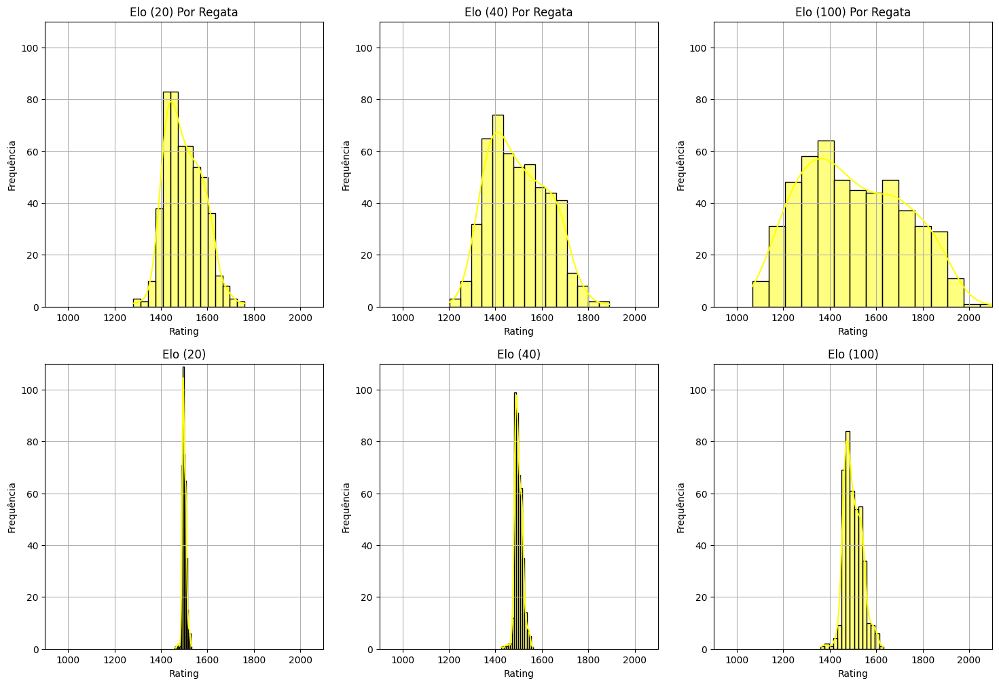

In [21]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[0, 0]);
axes[0, 0].set_xlim(900, 2100);
axes[0, 0].set_ylim(0, 110);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[0, 1]);
axes[0, 1].set_xlim(900, 2100);
axes[0, 1].set_ylim(0, 110);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[0, 2]);
axes[0, 2].set_xlim(900, 2100);
axes[0, 2].set_ylim(0, 110);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[1, 0]);
axes[1, 0].set_xlim(900, 2100);
axes[1, 0].set_ylim(0, 110);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[1, 1]);
axes[1, 1].set_xlim(900, 2100);
axes[1, 1].set_ylim(0, 110);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[1, 2]);
axes[1, 2].set_xlim(900, 2100);
axes[1, 2].set_ylim(0, 110);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [22]:
elo_40_49erfx.tail(10)

,Unnamed: 0,Rating
498,"MEGAN BRICKWOOD, STEPHANIE ORTON",1766.325854
499,"INGA-MARIE HOFMANN, CATHERINE BARTELHEIMER",1769.090680
500,"JO ALEH, MOLLY MEECH",1769.544477
501,"MARTINE SOFFIATTI GRAEL, KAHENA KUNZE",1772.689441
502,"VILMA BOBECK, REBECCA NETZLER",1776.430687
503,"JANA GERMANI, GIORGIA BERTUZZI",1777.045053
504,"LAURA HARDING, ANNIE WILMOT",1800.941061
505,"PATRICIA SUAREZ, NICOLE VAN DER VELDEN",1807.041091
506,"GRISELDA KHNG, SARA TAN",1866.044501
507,"ODILE VAN AANHOLT, ANNETTE DUETZ",1890.495262


In [23]:
elo_40_normal_49erfx.tail(10)

,Unnamed: 0,Rating
390,"TANJA FRANK, LORENA ABICHT",1542.596763
391,"MARTINE SOFFIATTI GRAEL, KAHENA KUNZE",1542.955573
392,"ALEXANDRA STALDER, SILVIA SPERI",1543.023438
393,"CARLOTTA OMARI, SVEVA CARRARO",1543.280467
394,"PATRICIA SUAREZ, NICOLE VAN DER VELDEN",1544.897636
395,"TESS LLOYD, CAITLIN ELKS",1546.922968
396,"IDA MARIE BAAD NIELSEN, MARIE THUSGAARD OLSEN",1548.427446
397,"TINA LUTZ, SUSANN BEUCKE",1548.847067
398,"NOORA RUSKOLA, MIKAELA WULFF",1549.105744
399,"MEGAN BRICKWOOD, STEPHANIE ORTON",1561.840517


# IQFOIL FEM.

In [18]:
elo_20_iqfem = pd.read_csv("../rankings_2024/novo/regata/elo-20-IQFOIL FEM._regata.csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_40_iqfem = pd.read_csv("../rankings_2024/novo/regata/elo-40-IQFOIL FEM._regata.csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_100_iqfem = pd.read_csv("../rankings_2024/novo/regata/elo-100-IQFOIL FEM._regata.csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)

elo_20_normal_iqfem = pd.read_csv("../rankings_2024/novo/normal/elo-20-IQFOIL FEM..csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_40_normal_iqfem = pd.read_csv("../rankings_2024/novo/normal/elo-40-IQFOIL FEM..csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_100_normal_iqfem = pd.read_csv("../rankings_2024/novo/normal/elo-100-IQFOIL FEM..csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)

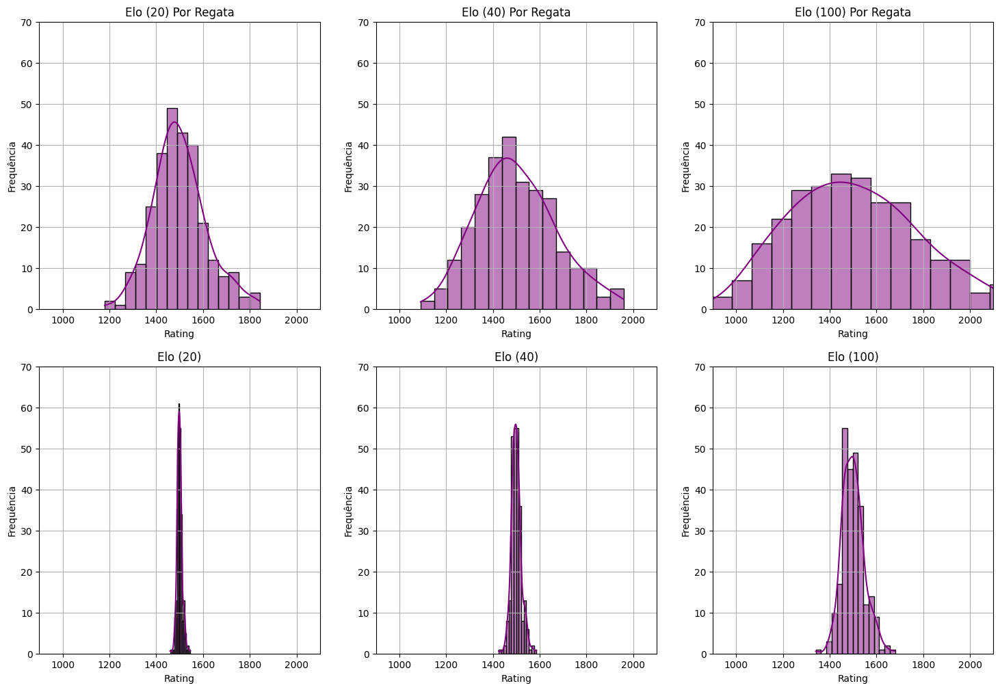

In [19]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[0, 0]);
axes[0, 0].set_xlim(900, 2100);
axes[0, 0].set_ylim(0, 70);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[0, 1]);
axes[0, 1].set_xlim(900, 2100);
axes[0, 1].set_ylim(0, 70);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[0, 2]);
axes[0, 2].set_xlim(900, 2100);
axes[0, 2].set_ylim(0, 70);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[1, 0]);
axes[1, 0].set_xlim(900, 2100);
axes[1, 0].set_ylim(0, 70);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[1, 1]);
axes[1, 1].set_xlim(900, 2100);
axes[1, 1].set_ylim(0, 70);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[1, 2]);
axes[1, 2].set_xlim(900, 2100);
axes[1, 2].set_ylim(0, 70);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

## FOTOGRAFIA ELO

In [5]:
def fotografia_elo(data:pd.DataFrame, classe:str, ano:int, elo_k:int) -> pd.DataFrame:
    
    data_temp = data[data['Classe Vela'] == classe]

    for competition in data_temp['Nome Competição']:
            data_temp.loc[data_temp['Nome Competição'] == competition, 'Ano'] = int(re.findall(r'\d{4}', competition)[0])
    
    data_temp = data_temp[(data_temp['Ano'] <= ano)]

    elo = EloRating(ratings={competitor: 1500 for competitor in data_temp['Nome Competidor'].unique()}, k=elo_k)

    grouped_data = data_temp.groupby(["Ano", "Nome Competição", "Regata", "Nome Competidor"]).agg({"Posição Geral": "min"}).sort_values(by=["Ano", "Nome Competição", "Regata", "Posição Geral"], ascending=True).reset_index()

    data_dict = []
    for ano in grouped_data["Ano"].unique():
        for comp in grouped_data[grouped_data["Ano"] == ano]["Nome Competição"].unique():
            for regata in grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Regata"].unique():
                results = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Posição Geral"].values
                names = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Nome Competidor"].values
                data_dict.append([results, names])

    elo.fit(data_dict)
    ratings = elo.ratings

    ratings = pd.DataFrame.from_dict(ratings, orient='index', columns=['Rating']).sort_values(by="Rating", ascending=False)

    return ratings

In [9]:
def race_chart(classe:str, elo_k:int) -> None:

    dict_classe = dict()
    for cada_ano in range(2015, 2025):
        dict_classe[cada_ano] = fotografia_elo(data, classe, cada_ano, elo_k)
        dict_classe[cada_ano]["Ano"] = cada_ano

    df_classe = pd.DataFrame(columns=["Rating", "Ano"])
    for cada_ano in range(2015, 2025):
        df_classe = pd.concat([df_classe, dict_classe[cada_ano]], axis=0)

    df_classe = df_classe.reset_index()
    df_classe = df_classe.rename(columns={'index': 'Nome Atleta'})

    df_auxiliar = pd.DataFrame(columns=df_classe["Nome Atleta"].unique(), index=range(2015, 2025))

    for each_atleta in df_classe["Nome Atleta"].unique():
        for each_year in range(2015, 2025):
            data_aux = df_classe[(df_classe["Nome Atleta"] == each_atleta) & (df_classe["Ano"] == each_year)]

            try:
                df_auxiliar.at[each_year, each_atleta] = float(data_aux.iloc[0]['Rating'])
            except:
                df_auxiliar.at[each_year, each_atleta] = 0
    
    df_auxiliar = df_auxiliar.apply(pd.to_numeric, errors='ignore')
    
    return df_auxiliar

In [30]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("ILCA 7", 40), 
    title=f'ELo 40 - ILCA 7', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [10]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("ILCA 6", 40), 
    title=f'ELo 40 - ILCA 6', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [11]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("49ER", 40), 
    title=f'ELo 40 - 49ER', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [12]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("49ERFX", 40), 
    title=f'ELo 40 - 49ERFX', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [13]:
iqfoil = race_chart("IQFOIL FEM.", 40)

In [14]:
iqfoil = iqfoil.loc[[2021, 2022, 2023, 2024]]

In [15]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=iqfoil, 
    title=f'ELo 40 - IQFOIL FEM.', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

## GIOVANNA PRADA

Trouxemos mais dados e, na prática, não mudou muita coisa. Pelo que pedemos observar, ela começou a competir em 2021 e, por isso, temos pouca amostragem dela. Os resultados são melhores, agora que terminamos a coleta, mas ainda não é suficiente. Provavelmente, por ser uma atleta jovem, ela ocilou em algumas competições (em algumas regatas) e, por isso, o modelo puniu o seu rating. 

In [20]:
posicao_20 = elo_20_iqfem.index[elo_20_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_40 = elo_40_iqfem.index[elo_40_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_100 = elo_100_iqfem.index[elo_100_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]

posicao_20_normal = elo_20_normal_iqfem.index[elo_20_normal_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_40_normal = elo_40_normal_iqfem.index[elo_40_normal_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_100_normal = elo_100_normal_iqfem.index[elo_100_normal_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]

print("Número de Competidores IQFOIL Feminino: 276.\n")
print("Giovanna Prada:")
print(f"- Posição Elo 20: {posicao_20_normal}ª")
print(f"- Posição Elo 40: {posicao_40_normal}ª")
print(f"- Posição Elo 100: {posicao_100_normal}ª")

print(f"- Posição Elo 20 Por Regata: {posicao_20}ª")
print(f"- Posição Elo 40 Por Regata: {posicao_40}ª")
print(f"- Posição Elo 100 Por Regata: {posicao_100}ª")

Número de Competidores IQFOIL Feminino: 276.

Giovanna Prada:
- Posição Elo 20: 96ª
- Posição Elo 40: 101ª
- Posição Elo 100: 121ª
- Posição Elo 20 Por Regata: 192ª
- Posição Elo 40 Por Regata: 191ª
- Posição Elo 100 Por Regata: 178ª


In [34]:
data[data["Nome Competidor"] == "GIOVANNA PRADA"]["Nome Competição"].unique()

array(['European Championship 2023', 'European Championship 2022',
       'European Championship 2021 - Gold Fleet & Medal Race',
       'World Championship 2021', 'World Championship 2023',
       'World Championship 2024'], dtype=object)

In [36]:
df_classe = pd.DataFrame(columns=["index", "Rating", "Ano"])

for cada_ano in range(2021, 2025):
    df_aux = fotografia_elo(data, "IQFOIL FEM.", cada_ano, 20)
    df_aux["Ano"] = cada_ano
    df_aux = df_aux.reset_index() 
    df_classe = pd.concat([df_classe, df_aux], axis=0)

df_classe.index = df_classe.index + 1

df_classe[df_classe["index"] == "GIOVANNA PRADA"]

,index,Rating,Ano
21,GIOVANNA PRADA,1576.319949,2021
36,GIOVANNA PRADA,1570.647226,2022
153,GIOVANNA PRADA,1472.188012,2023
193,GIOVANNA PRADA,1438.866487,2024


In [37]:
df_classe = pd.DataFrame(columns=["index", "Rating", "Ano"])

for cada_ano in range(2020, 2025):
    df_aux = fotografia_elo(data, "IQFOIL FEM.", cada_ano, 40)
    df_aux["Ano"] = cada_ano
    df_aux = df_aux.reset_index()  # Correção aqui
    df_classe = pd.concat([df_classe, df_aux], axis=0)

df_classe.index = df_classe.index + 1

df_classe[df_classe["index"] == "GIOVANNA PRADA"]

,index,Rating,Ano
24,GIOVANNA PRADA,1615.887071,2021
41,GIOVANNA PRADA,1588.127516,2022
168,GIOVANNA PRADA,1428.448588,2023
192,GIOVANNA PRADA,1405.469955,2024


In [38]:
df_classe = pd.DataFrame(columns=["index", "Rating", "Ano"])

for cada_ano in range(2020, 2025):
    df_aux = fotografia_elo(data, "IQFOIL FEM.", cada_ano, 100)
    df_aux["Ano"] = cada_ano
    df_aux = df_aux.reset_index()  # Correção aqui
    df_classe = pd.concat([df_classe, df_aux], axis=0)

df_classe.index = df_classe.index + 1

df_classe[df_classe["index"] == "GIOVANNA PRADA"]

,index,Rating,Ano
25,GIOVANNA PRADA,1672.494571,2021
50,GIOVANNA PRADA,1602.824844,2022
177,GIOVANNA PRADA,1359.722294,2023
179,GIOVANNA PRADA,1378.050493,2024


## NOMES

In [172]:
matriz_da_distancia = pd.DataFrame(columns=data["Nome Competidor"].unique(), index=data["Nome Competidor"].unique())

lista_nome_1 = list()
lista_nome_2 = list()
lista_dist = list()

def levenshtein_distance(string1, string2):
    return Levenshtein.distance(string1, string2)

for index1 in matriz_da_distancia.index:
    for index2 in matriz_da_distancia.columns:
        distance = levenshtein_distance(index1, index2)
        if distance <= 3 and distance > 0:
            lista_nome_1.append(index1)
            lista_nome_2.append(index2)
            lista_dist.append(distance)

        matriz_da_distancia.at[index1, index2] = distance

In [173]:
df_distance = pd.DataFrame()
df_distance["Nome 1"] = lista_nome_1
df_distance["Nome 2"] = lista_nome_2
df_distance["Distance"] = lista_dist

In [174]:
df_distance

,Nome 1,Nome 2,Distance
0,PILAR LAMADRID TRUEBA,PILAR LAMADRID-TRUEBA,1
1,PALMA ?ARGO,PALMA CARGO,1
2,MAYA MORRIS,MAC MORRIN,3
3,NICOLE VAN DER VELDEN,NICOLE VAN-DER-VELDEN,2
4,THERESA MARIE STEINLEIN,THERESA-MARIE STEINLEIN,1
...,...,...,...
363,MATHEW BARTON,MATTHEW BARTON,1
364,"YANG, HU","WANG, QI",3
365,"MAI, CHEN",HAO CHEN,3
366,"ZHAO, WANG","CHEN, WANG",3


## BANCO DE DADOS

In [7]:
engine = create_engine('sqlite:///elo_ranking.db', echo=False)

for classe in ["ILCA 7", "ILCA 6", "49ER", "49ERFX", "IQFOIL FEM."]:
    rks = []
    for ano in range(2015, 2025):
        # function to get the ranking by year
        df_y = fotografia_elo(data, classe, ano, 40)
        # add year column
        df_y['Year'] = ano
        rks.append(df_y)

    df = pd.concat(rks)

    df = df.reset_index()

    df.to_sql(f'{classe}', con=engine, if_exists='replace', index=False)

C:\Users\mathe\AppData\Local\Temp\ipykernel_14956\1458287691.py:12: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(rks)
